<a href="https://colab.research.google.com/github/cocozhang98/ECE1512_2022W_ProjectRepo_Coco_Zhang/blob/main/HMT_Pretrained.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import os
os.chdir(r'/content/drive/My Drive/ECE1512_ProjectA')  # Change the directory to torchRay-master folder

# Requirements

In [21]:
import os
import numpy as np
import pandas as pd
import tensorflow as tf
import keras
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Dense, Flatten
from keras import regularizers
import keras.backend as K
from keras.models import load_model
from tensorflow.core.util import event_pb2
from tensorflow.python.lib.io import tf_record
import matplotlib.pyplot as plt
import sklearn.metrics as metrics
import cv2

In [26]:
from xai_utils import *

# Dataset loader

In [5]:
train_dir = '/content/drive/My Drive/ECE1512_ProjectA/hmt_dataset/HMT_train' #you should change to your directory
test_dir = '/content/drive/My Drive/ECE1512_ProjectA/hmt_dataset/HMT_test' #you should change to your directory

train_datagen = ImageDataGenerator(rescale=1/255.,
shear_range=0.1,
rotation_range=15,
horizontal_flip=True,
vertical_flip=True)

test_datagen = ImageDataGenerator(rescale=1/255.)

train_generator = train_datagen.flow_from_directory(train_dir,
class_mode='categorical',
interpolation='bilinear',
target_size=(224, 224),
batch_size=32,
shuffle=True)

test_generator = test_datagen.flow_from_directory(test_dir,
class_mode='categorical',
interpolation='bilinear',
target_size=(224, 224),
batch_size=1,
shuffle=False)

Found 4504 images belonging to 8 classes.
Found 496 images belonging to 8 classes.


In [6]:
classes=['Tumor', 'Stroma', 'Complex', 'Lympho', 'Debris', 'Mucosa', 'Adipose', 'Empty']

# Load model

In [7]:
model=load_model('models/HMT.h5')

# Performance

In [8]:
test_generator.reset()
y_probs = np.zeros((496,8))
y_onehot = np.zeros((496,8))
y_pred_onehot = np.zeros((496,8))
y_label = np.zeros((496,1))
y_pred_label = np.zeros((496,1))
for i in range(496):
  image,label=test_generator.next()
  prediction=model(image)[0].numpy()
  y_probs[i,:] = prediction
  y_onehot[i,:] = label[0]
  y_pred_onehot[i,np.argmax(prediction)] = 1
  y_pred_label[i] = np.argmax(prediction)
  y_label[i] = np.argmax(label)

In [ ]:
#3b - Overall classification accuracy
overall_accuracy = metrics.accuracy_score(y_label, y_pred_label, normalize=True)
print("Overall classification accuracy on test set is: %f" % overall_accuracy)

Overall classification accuracy on test set is: 0.834677


In [18]:
#3c - Class-wise classfication accuracy
confusion_matrix = metrics.confusion_matrix(y_label, y_pred_label, normalize='true')
for i in range(8):
  print("Classwise classification accuracy for the %s class %d is: %f" % (classes[i], i, confusion_matrix[i][i]))


Classwise classification accuracy for the Tumor class 0 is: 0.854839
Classwise classification accuracy for the Stroma class 1 is: 0.758065
Classwise classification accuracy for the Complex class 2 is: 0.774194
Classwise classification accuracy for the Lympho class 3 is: 0.854839
Classwise classification accuracy for the Debris class 4 is: 0.661290
Classwise classification accuracy for the Mucosa class 5 is: 0.822581
Classwise classification accuracy for the Adipose class 6 is: 0.951613
Classwise classification accuracy for the Empty class 7 is: 1.000000


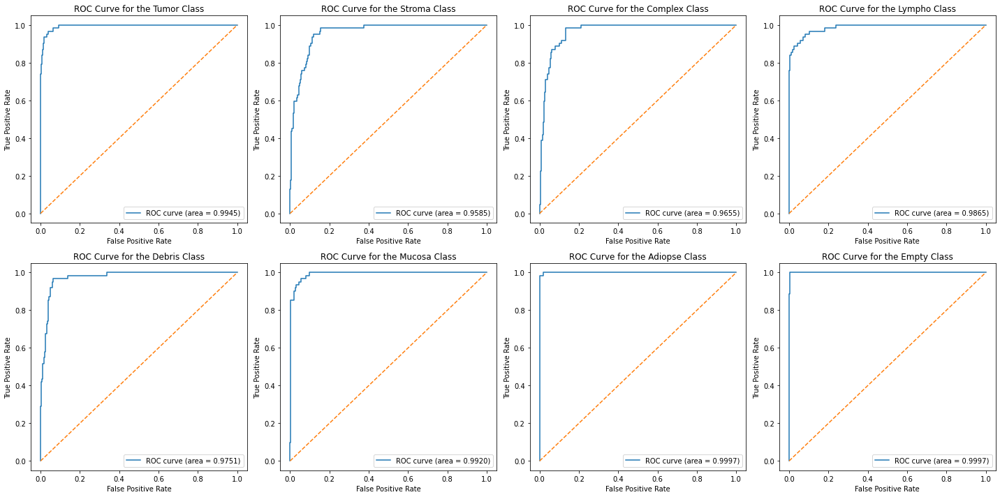

In [ ]:
#3d ROC and AUC curves
fpr = dict()
tpr = dict()
roc_auc = dict()

plt.figure(figsize=(20,10))
for i in range(8):
    fpr[i], tpr[i], _ = metrics.roc_curve(y_onehot[:, i], y_probs[:, i])
    roc_auc[i] = metrics.auc(fpr[i], tpr[i])
    plt.subplot(2,4,i+1)
    plt.plot(fpr[i], tpr[i], label='ROC curve (area = %0.4f)' % roc_auc[i])
    plt.plot([0,1],[0,1],'--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title("ROC Curve for the %s Class" % classes[i])
    plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
print("The AOC for each class (as specified on the plot legends) are:")
for i in range(8):
  print("  %s: %f" % (classes[i], roc_auc[i]))

The AOC for each class (as specified on the plot legends) are:
  Tumor: 0.994463
  Stroma: 0.958488
  Complex: 0.965549
  Lympho: 0.986472
  Debris: 0.975100
  Mucosa: 0.991973
  Adiopse: 0.999666
  Empty: 0.999740


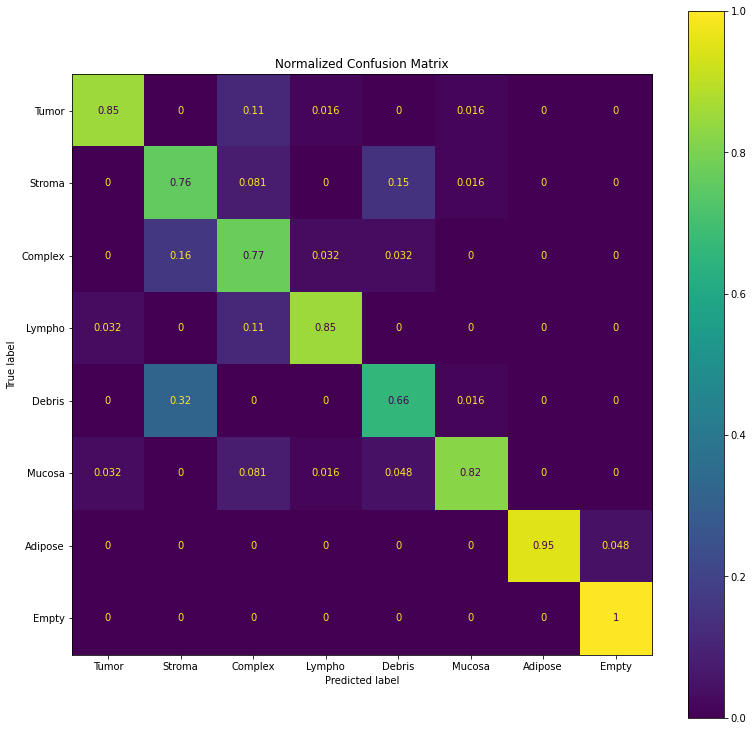

In [12]:
# 3e Normalized confusion matrix
fig, ax = plt.subplots(figsize=(13,13))
disp = metrics.ConfusionMatrixDisplay.from_predictions(y_label.reshape((496,1)), y_pred_label.reshape((496,1)), normalize='true',ax=ax)
ax.set_title("Normalized Confusion Matrix")
plt.xticks([0,1,2,3,4,5,6,7],classes)
plt.yticks([0,1,2,3,4,5,6,7],classes)
plt.show()

In [ ]:
# 3f Precision, Recall, and F-1 score
precision, recall, f1, _ = metrics.precision_recall_fscore_support(y_label, y_pred_label, average='micro')
print("Precision, Recall, and F-1 score for whole set: ")
print("  Precision: %f" % precision)
print("  Recall: %f" % recall)
print("  F-1: %f" % f1)
for i in range(8):
  precision, recall, f1, _ = metrics.precision_recall_fscore_support(y_label, y_pred_label, labels=[i], average = 'micro')
  print("Precision, Recall, and F-1 score for class %s: " %classes[i])
  print("  Precision: %f" % precision)
  print("  Recall: %f" % recall)
  print("  F-1: %f" % f1)

Precision, Recall, and F-1 score for whole set: 
  Precision: 0.834677
  Recall: 0.834677
  F-1: 0.834677
Precision, Recall, and F-1 score for class Tumor: 
  Precision: 0.929825
  Recall: 0.854839
  F-1: 0.890756
Precision, Recall, and F-1 score for class Stroma: 
  Precision: 0.610390
  Recall: 0.758065
  F-1: 0.676259
Precision, Recall, and F-1 score for class Complex: 
  Precision: 0.666667
  Recall: 0.774194
  F-1: 0.716418
Precision, Recall, and F-1 score for class Lympho: 
  Precision: 0.929825
  Recall: 0.854839
  F-1: 0.890756
Precision, Recall, and F-1 score for class Debris: 
  Precision: 0.745455
  Recall: 0.661290
  F-1: 0.700855
Precision, Recall, and F-1 score for class Mucosa: 
  Precision: 0.944444
  Recall: 0.822581
  F-1: 0.879310
Precision, Recall, and F-1 score for class Adiopse: 
  Precision: 1.000000
  Recall: 0.951613
  F-1: 0.975207
Precision, Recall, and F-1 score for class Empty: 
  Precision: 0.953846
  Recall: 1.000000
  F-1: 0.976378


# Visualization

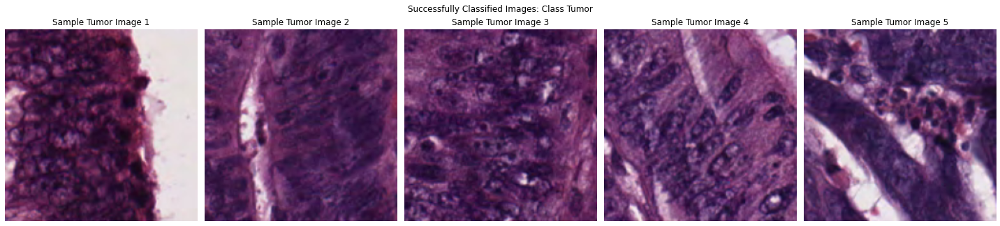

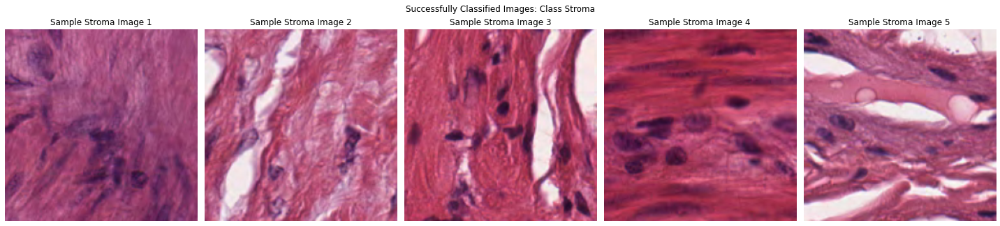

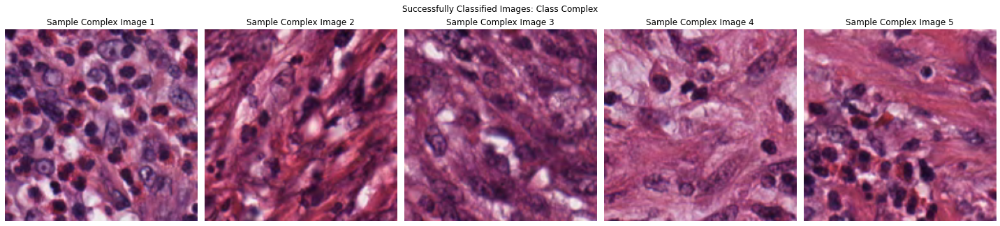

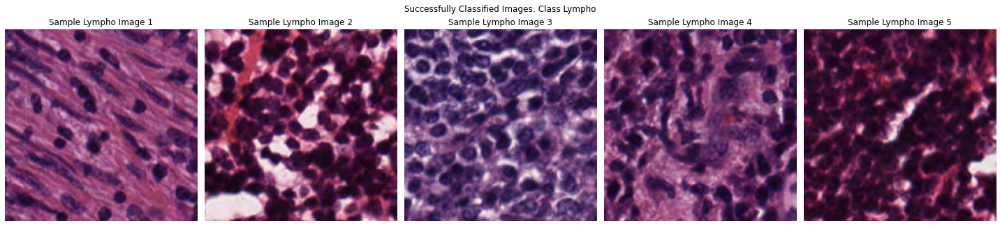

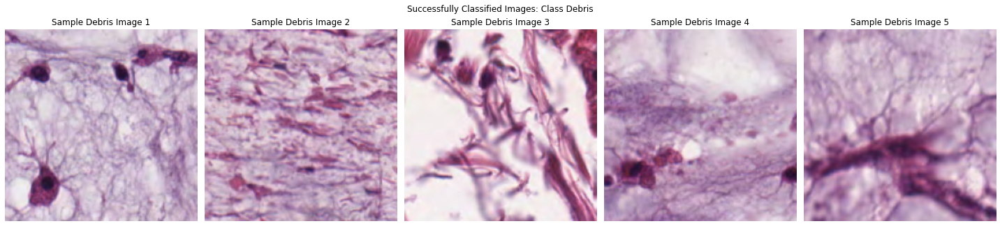

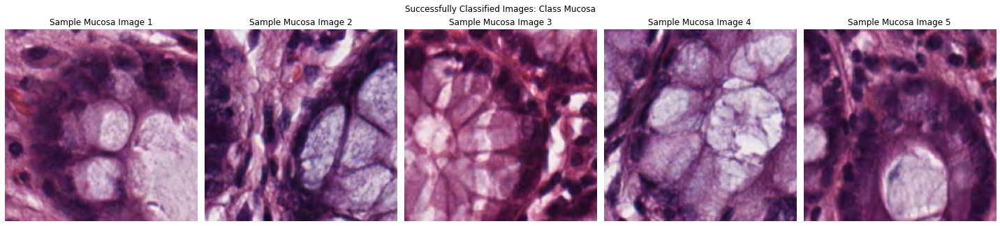

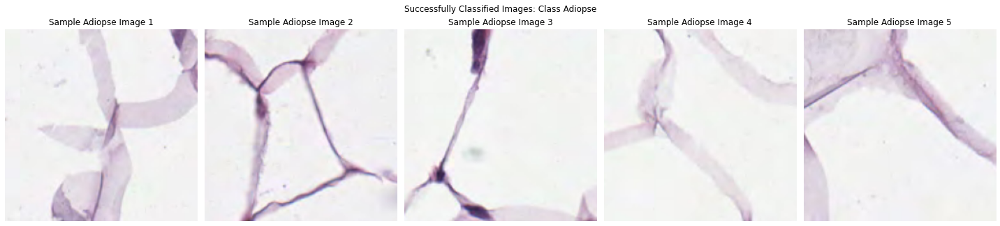

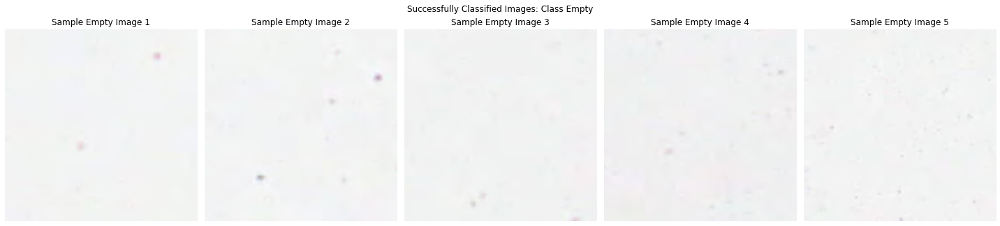

In [ ]:
# 4. Code to show success/failure cases
test_generator.reset()
for i in range(8):
  plt.figure(figsize=(25,5))
  plt.suptitle('Successfully Classified Images: Class %s' % classes[i])
  j = 0
  while (j < 5):
    image,label=test_generator.next()
    prediction=model(image)[0].numpy()
    if (np.argmax(label)>i):
        break
    if (np.argmax(label) == i) and (np.argmax(prediction) == np.argmax(label)):
      plt.subplot(1,5,j+1)
      plt.imshow(image[0])
      plt.axis('off')
      plt.title('Sample %s Image %d' % (classes[np.argmax(label)],(j+1)))
      j += 1
  plt.tight_layout()
  plt.show()

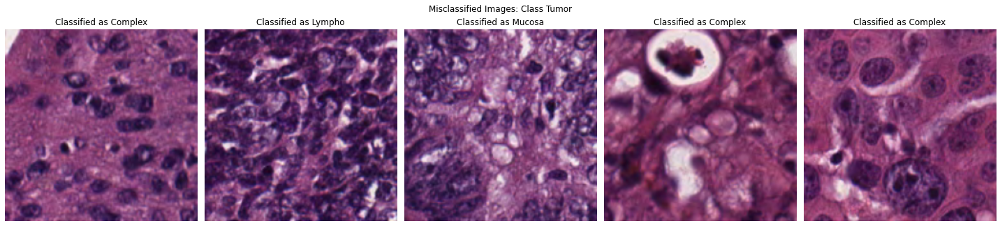

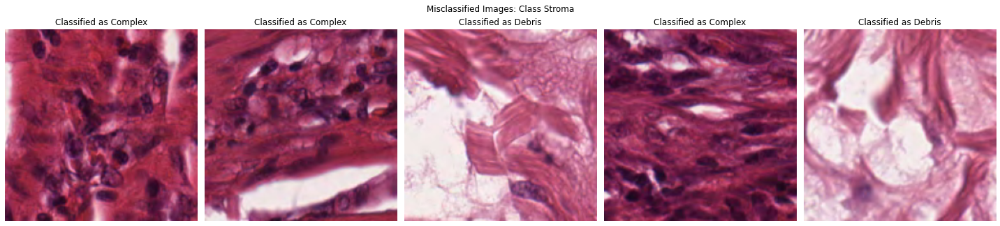

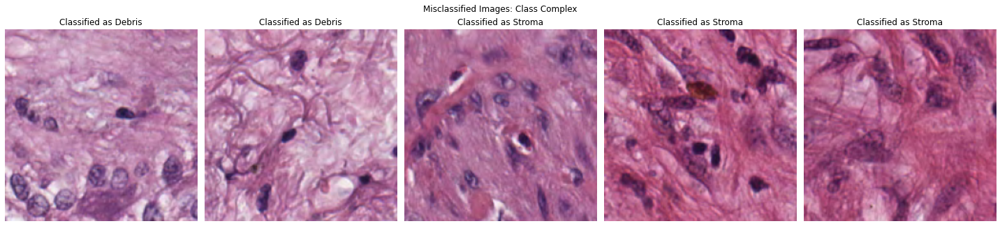

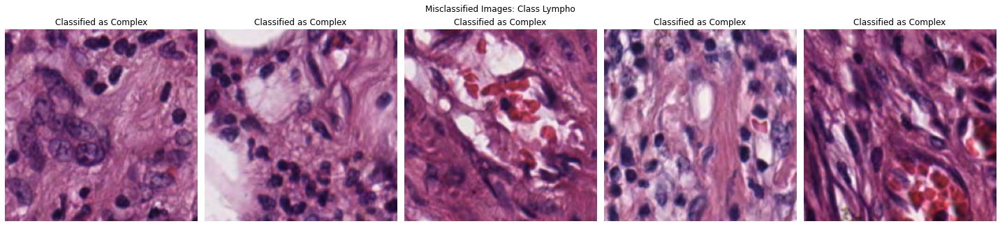

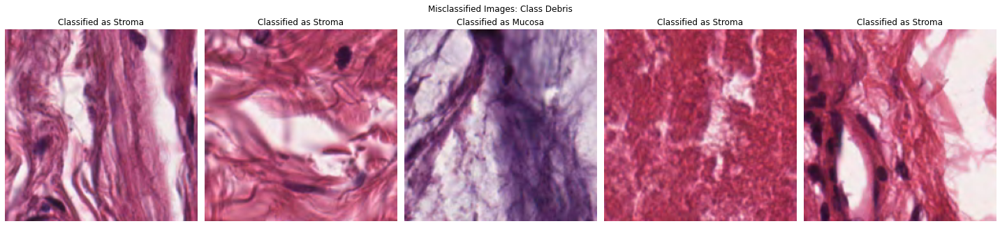

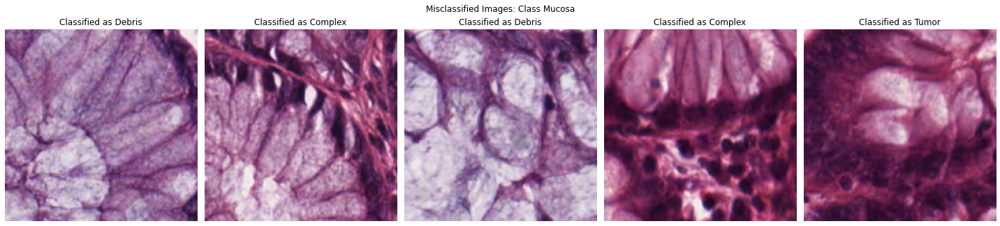

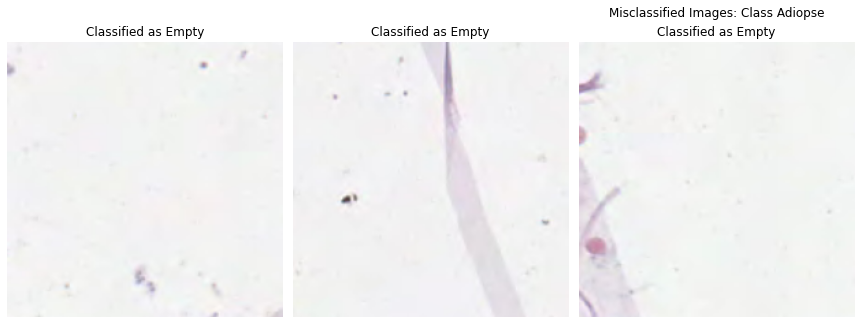

In [ ]:
test_generator.reset()
label = [1,0,0,0,0,0,0,0]
for i in range(7):
  plt.figure(figsize=(20,5))
  plt.suptitle('Misclassified Images: Class %s' % classes[i])
  j = 0
  while (j < 5):
    image,label=test_generator.next()
    prediction=model(image)[0].numpy()
    if (np.argmax(label) == i):
      if (np.argmax(prediction) != np.argmax(label)):
        plt.subplot(1,5,j+1)
        plt.imshow(image[0])
        plt.axis('off')
        plt.title('Classified as %s' % (classes[np.argmax(prediction)]))
        j += 1
    if (np.argmax(label) == 7): #All empty images are correctly classified; by this point all 3 misclassified Adiopse images are plotted
      j = 5
  plt.tight_layout()
  plt.show()



# Explanation

In [245]:
classes=['Tumor', 'Stroma', 'Complex', 'Lympho', 'Debris', 'Mucosa', 'Adiopse', 'Empty']
test_generator.reset()

In [246]:
image_batch,label_batch=test_generator.next()

In [247]:
prediction=model(image_batch)
print('True label: '+classes[np.argmax(label_batch[0])])
print('Predicted_label: '+classes[np.argmax(prediction[0])])
print('Confidence score for the correct label: '+str(prediction[0][np.argmax(label_batch[0])].numpy()))

True label: Tumor
Predicted_label: Tumor
Confidence score for the correct label: 0.85581267


##SISE

In [248]:
layers=[['conv2d_3']]

In [270]:
%%time
explanation_map_SISE = SISE(np.expand_dims(image_batch[0], axis=0), model, layers=layers, class_index=np.argmax(prediction[0]), grad_thr=0.)

CPU times: user 128 ms, sys: 1.88 ms, total: 130 ms
Wall time: 141 ms


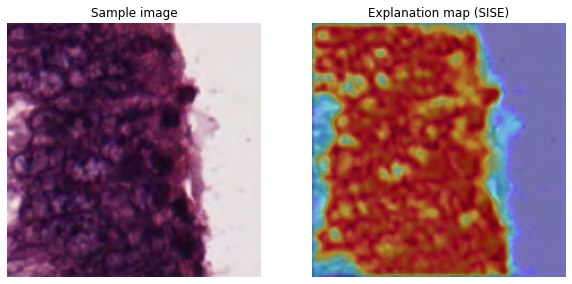

In [279]:
explanation_map_SISE -= explanation_map_SISE.min()
explanation_map_SISE /= explanation_map_SISE.max()+10e-30
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(image_batch[0])
plt.axis('off')
plt.title('Sample image')

plt.subplot(1,2,2)
plt.imshow(image_batch[0])
plt.imshow(explanation_map_SISE, cmap='jet', alpha=0.5)
plt.axis('off')
plt.title('Explanation map (SISE)')
plt.show()


## Integrated Gradient

### IG code

In [42]:
def get_gradients(input, model, pred_index):
  image = tf.convert_to_tensor(input)
  with tf.GradientTape() as tape:
    tape.watch(image)
    prediction=model(image)
    gradient = tape.gradient(prediction[:, pred_index],image)
  return gradient

def Integrated_Gradient(input, model, label, num_steps):
  steps = np.linspace(0.,1.,num_steps+1)[1:]
  intermediate_images = np.empty((num_steps,224,224,3))
  for i in range(num_steps):
    intermediate_images[i] = image_batch[0] * steps[i]
  gradients = get_gradients(intermediate_images, model, label)
  integral_gradients = tf.math.reduce_mean(gradients,axis=0) #Integral of steps is essentially the average
  integral_gradients = input * integral_gradients
  return integral_gradients

In [268]:
%%time
explanation_map_IG = Integrated_Gradient(image_batch[0], model, np.argmax(prediction[0]), 50).numpy()

CPU times: user 60.2 ms, sys: 5.27 ms, total: 65.5 ms
Wall time: 165 ms


### Find best way to plot

In [369]:
test_generator = test_datagen.flow_from_directory(test_dir,
class_mode='categorical',
interpolation='bilinear',
target_size=(224, 224),
batch_size=1,
shuffle=True)

Found 496 images belonging to 8 classes.


In [337]:
# Compare the different visualization methods 

def plot(explanation_map_IG, prediction):
  explanation_map_IG_avg = np.average(explanation_map_IG,axis=2)
  explanation_map_IG_avg -= explanation_map_IG_avg.min()
  explanation_map_IG_avg /= explanation_map_IG_avg.max()+10e-30
  
  explanation_map_IG_abs_avg = np.average(abs(explanation_map_IG),axis=2)
  explanation_map_IG_abs_avg -= explanation_map_IG_abs_avg.min()
  explanation_map_IG_abs_avg /= explanation_map_IG_abs_avg.max()+10e-30

  num_figures = 5
  plt.figure(figsize=(5*num_figures,5))
  plt.subplot(1,num_figures,1)
  plt.imshow(image_batch[0])
  plt.axis('off')
  plt.title('Image: Label=%s, Confidence=%.2f' % (classes[np.argmax(prediction[0])],prediction[0][np.argmax(prediction[0])]))

  plt.subplot(1,num_figures,2)
  plt.imshow(image_batch[0])
  plt.imshow(explanation_map_IG_avg, cmap='jet',alpha=0.5)
  plt.axis('off')
  plt.title('Explanation map (IG) masked over image')

  plt.subplot(1,num_figures,3)
  plt.imshow(image_batch[0])
  plt.imshow(explanation_map_IG_abs_avg, cmap='jet',alpha=0.5)
  plt.axis('off')
  plt.title('Explanation map (IG-abs) masked over image')

  plt.subplot(1,num_figures,4)
  IG_vis_image = image_batch[0]
  IG_vis_image[:,:,0] = IG_vis_image[:,:,0]*explanation_map_IG_abs_avg
  IG_vis_image[:,:,1] = IG_vis_image[:,:,1]*explanation_map_IG_abs_avg
  IG_vis_image[:,:,2] = IG_vis_image[:,:,2]*explanation_map_IG_abs_avg
  plt.imshow(IG_vis_image)
  plt.axis('off')
  plt.title('Explanation map (IG-abs * image)')

  plt.subplot(1,num_figures,5)
  plt.imshow(image_batch[0])
  plt.imshow(IG_vis_image)
  plt.axis('off')
  plt.title('Explanation map image + (IG-abs * image)')

  plt.show()

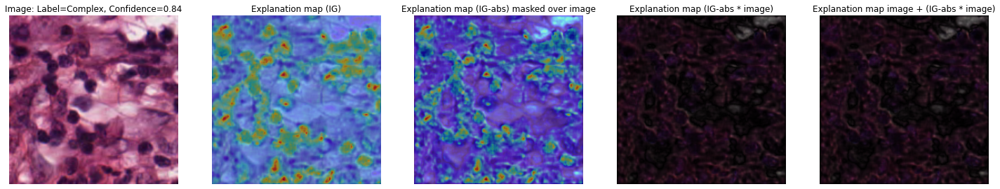

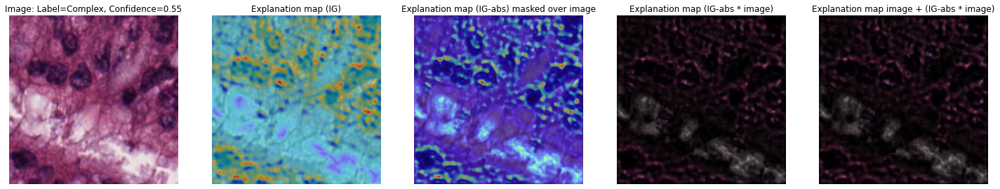

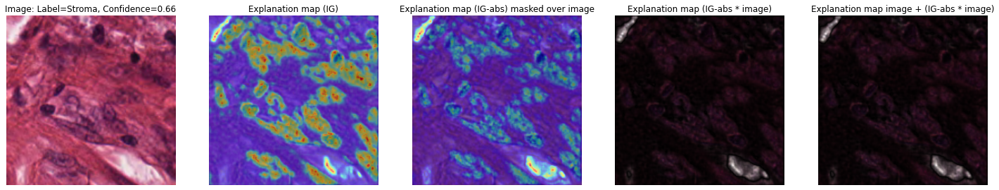

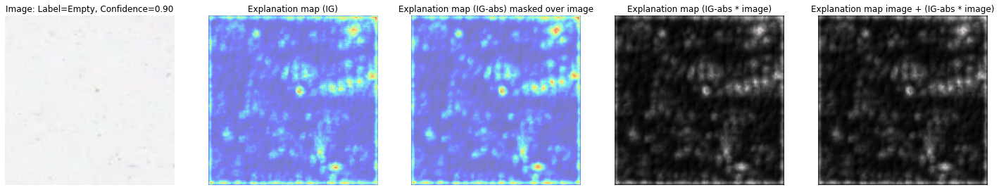

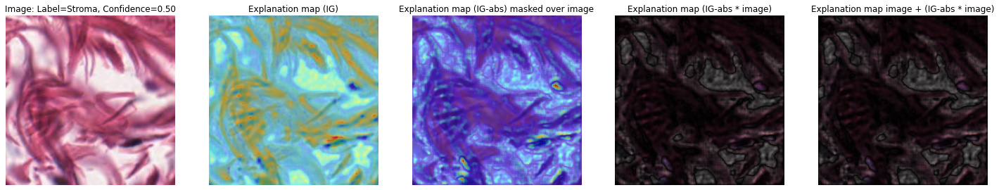

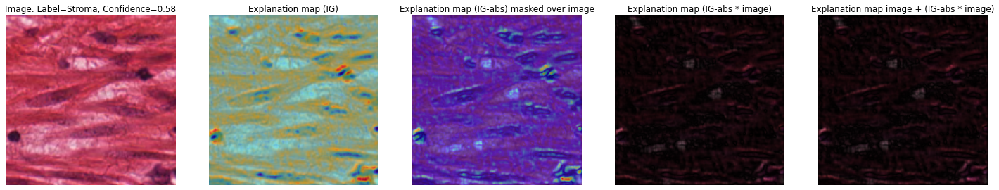

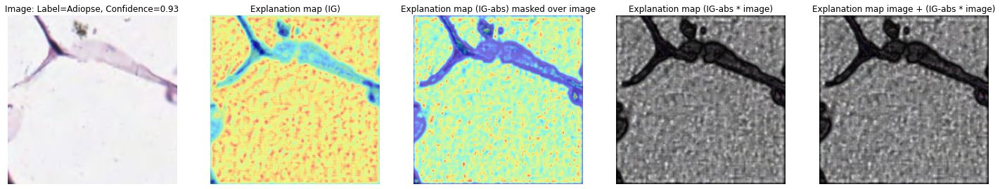

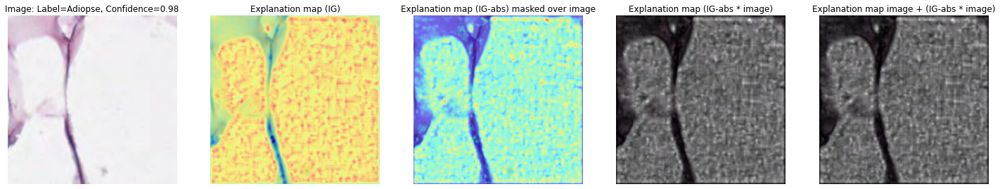

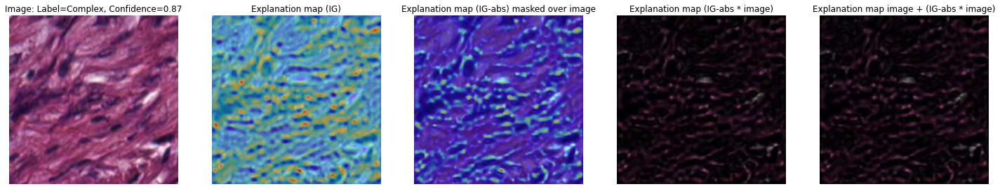

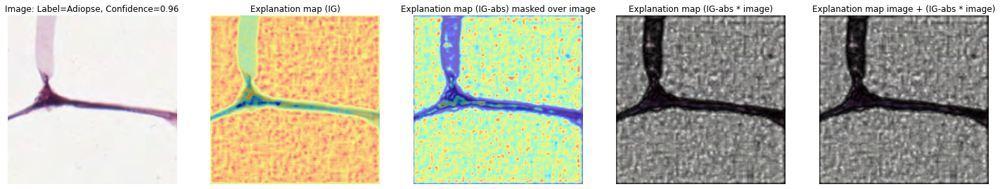

In [309]:
#This was ran twice to produce images
for i in range(10):
  image_batch,label_batch=test_generator.next()
  prediction = model(image_batch)
  explanation_map_IG = Integrated_Gradient(image_batch[0], model, np.argmax(prediction[0]), 50).numpy()
  plot(explanation_map_IG,prediction)

## Plot examples for both visualizations for comparison

In [361]:
test_generator = test_datagen.flow_from_directory(test_dir,class_mode='categorical',interpolation='bilinear',target_size=(224, 224),batch_size=1,shuffle=True)

Found 496 images belonging to 8 classes.


### Examples for success images
Note that helper function was buggy so this is very long 

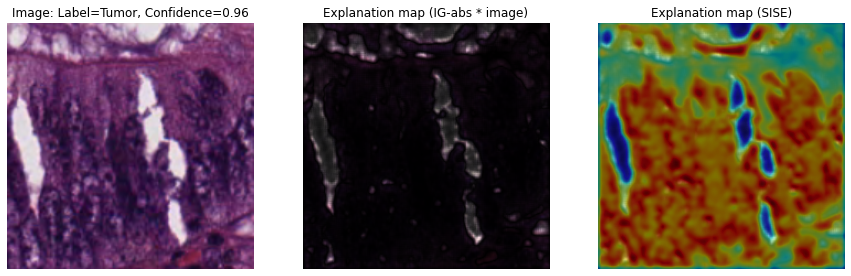

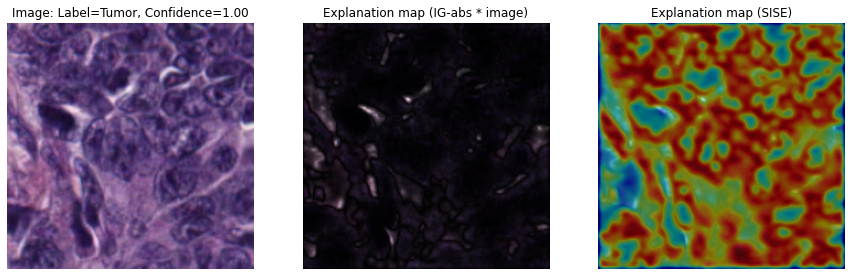

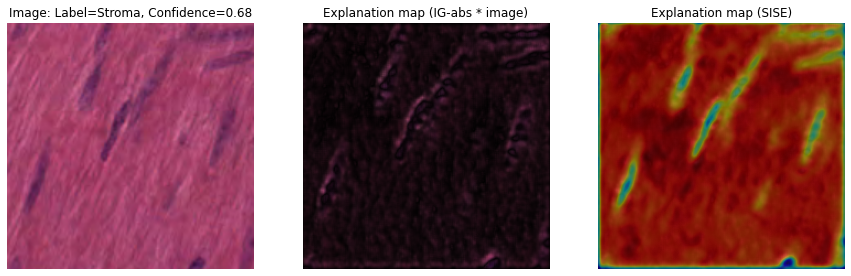

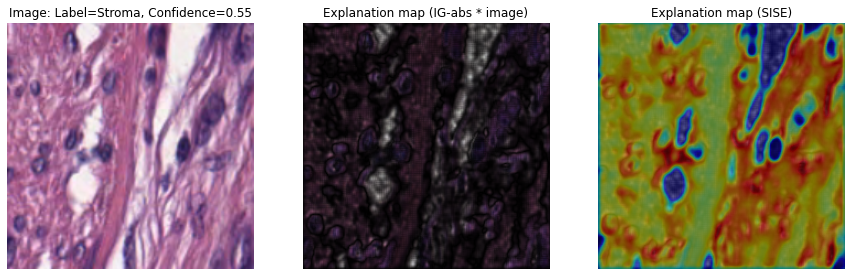

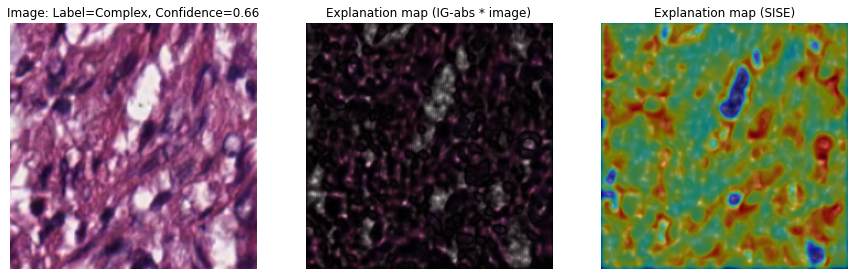

...

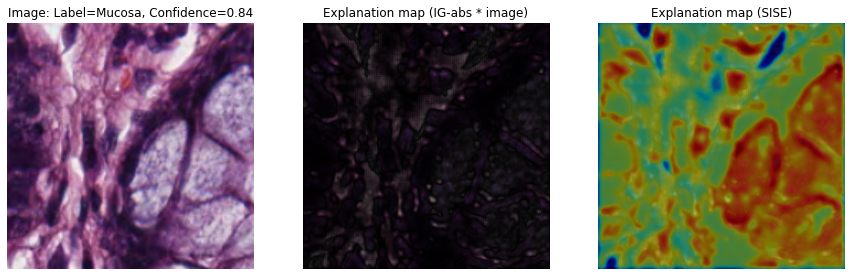

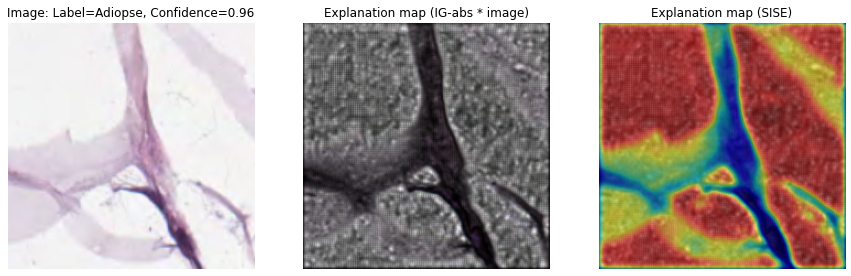

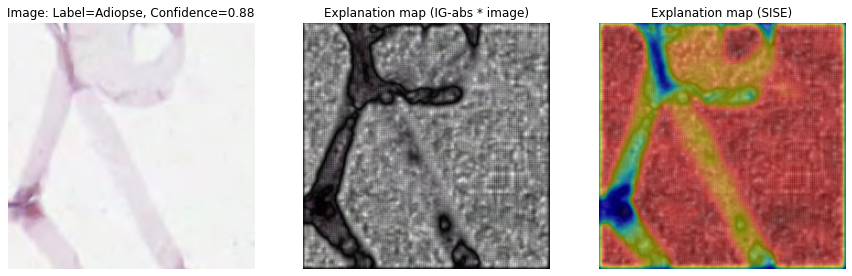

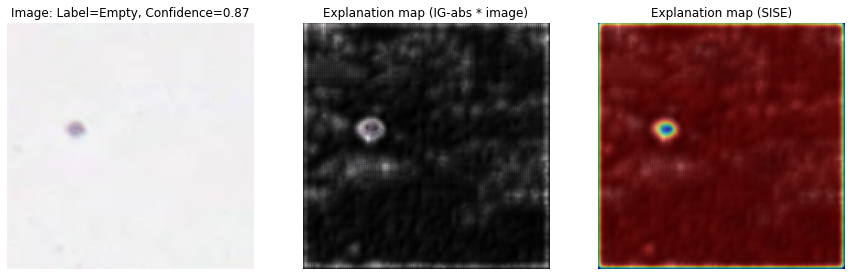

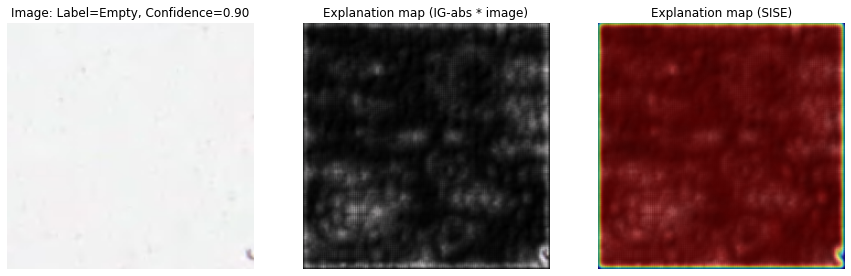

In [376]:
test_generator.reset()

for i in range(8):
  j = 0
  while (j < 2):
    image_batch,label_batch=test_generator.next()
    prediction = model(image_batch)
    if (np.argmax(label_batch[0]) == i) and (np.argmax(prediction[0]) == np.argmax(label_batch[0])):
      explanation_map_IG = Integrated_Gradient(image_batch[0], model, np.argmax(prediction[0]), 50).numpy()
      explanation_map_IG_abs_avg = np.average(abs(explanation_map_IG),axis=2)
      explanation_map_IG_abs_avg -= explanation_map_IG_abs_avg.min()
      explanation_map_IG_abs_avg /= explanation_map_IG_abs_avg.max()+10e-30

      explanation_map_SISE = SISE(np.expand_dims(image_batch[0], axis=0), model, layers=layers, class_index=np.argmax(prediction[0]), grad_thr=0.)
      explanation_map_SISE -= explanation_map_SISE.min()
      explanation_map_SISE /= explanation_map_SISE.max()+10e-30
      num_figures = 3
      plt.figure(figsize=(5*num_figures,5))
      plt.subplot(1,num_figures,1)
      plt.imshow(image_batch[0])
      plt.axis('off')
      plt.title('Image: Label=%s, Confidence=%.2f' % (classes[np.argmax(prediction[0])],prediction[0][np.argmax(prediction[0])]))

      plt.subplot(1,num_figures,2)
      IG_vis_image = image_batch[0]
      IG_vis_image[:,:,0] = IG_vis_image[:,:,0]*explanation_map_IG_abs_avg
      IG_vis_image[:,:,1] = IG_vis_image[:,:,1]*explanation_map_IG_abs_avg
      IG_vis_image[:,:,2] = IG_vis_image[:,:,2]*explanation_map_IG_abs_avg
      plt.imshow(IG_vis_image)
      plt.axis('off')
      plt.title('Explanation map (IG-abs * image)')

      plt.subplot(1,num_figures,3)
      plt.imshow(image_batch[0])
      plt.imshow(explanation_map_SISE, cmap='jet', alpha=0.5)
      plt.axis('off')
      plt.title('Explanation map (SISE)')
      plt.show()

      j = j + 1




### Examples for failed images

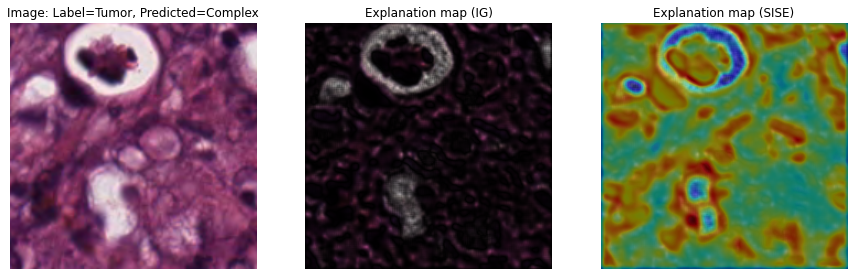

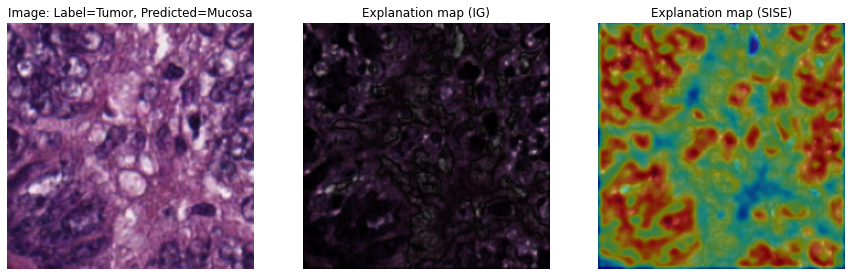

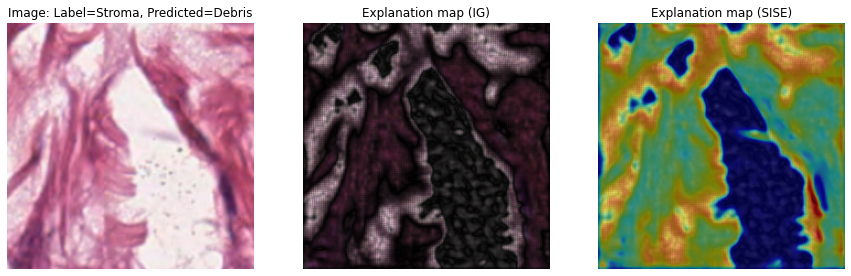

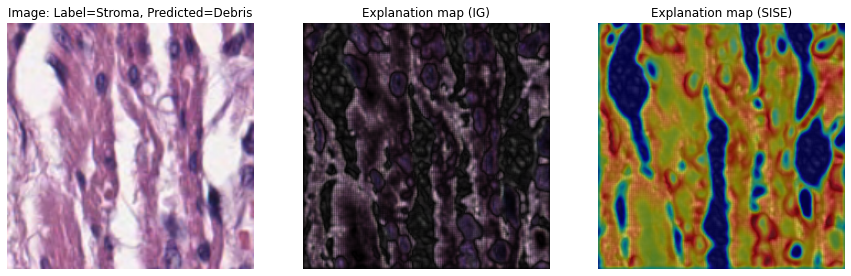

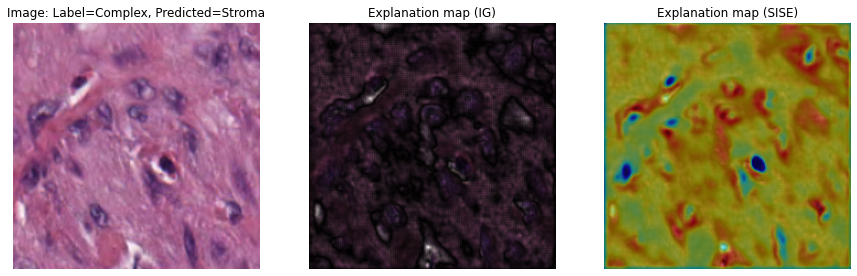

...

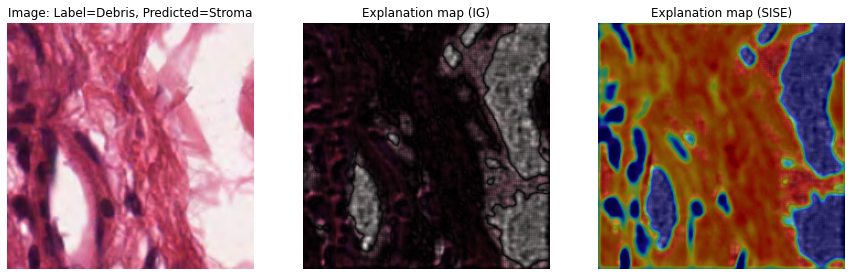

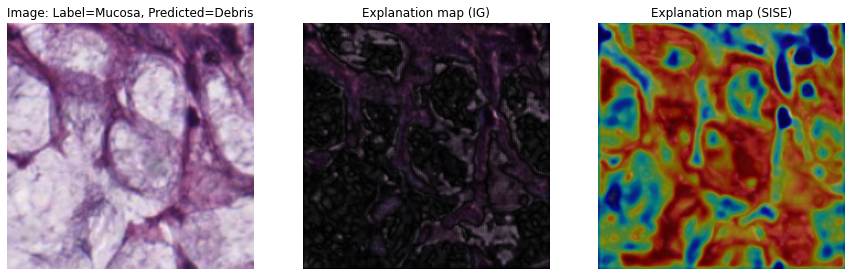

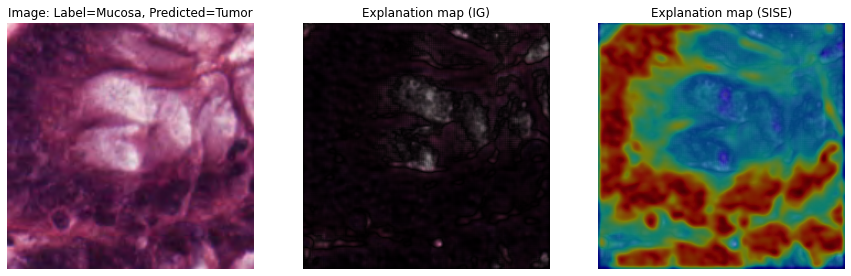

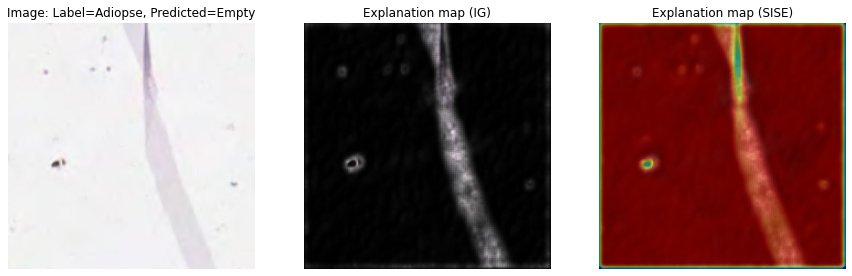

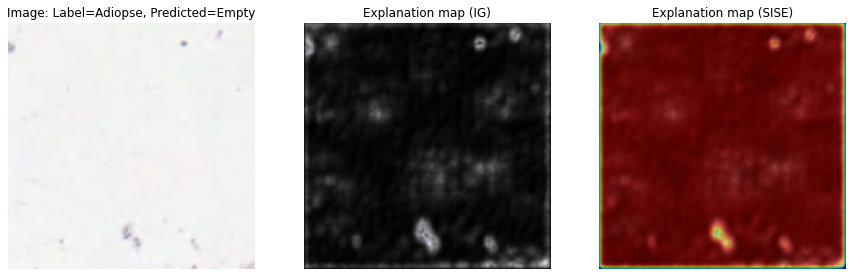

In [380]:
test_generator.reset()

for i in range(7): #No misclassified empty image
  j = 0
  while (j < 2):
    image_batch,label_batch=test_generator.next()
    prediction = model(image_batch)
    if (np.argmax(label_batch[0]) == i) and (np.argmax(prediction[0]) != np.argmax(label_batch[0])):
      explanation_map_IG = Integrated_Gradient(image_batch[0], model, np.argmax(prediction[0]), 50).numpy()
      explanation_map_IG_abs_avg = np.average(abs(explanation_map_IG),axis=2)
      explanation_map_IG_abs_avg -= explanation_map_IG_abs_avg.min()
      explanation_map_IG_abs_avg /= explanation_map_IG_abs_avg.max()+10e-30

      explanation_map_SISE = SISE(np.expand_dims(image_batch[0], axis=0), model, layers=layers, class_index=np.argmax(prediction[0]), grad_thr=0.)
      explanation_map_SISE -= explanation_map_SISE.min()
      explanation_map_SISE /= explanation_map_SISE.max()+10e-30
      num_figures = 3
      plt.figure(figsize=(5*num_figures,5))
      plt.subplot(1,num_figures,1)
      plt.imshow(image_batch[0])
      plt.axis('off')
      plt.title('Image: Label=%s, Predicted=%s' % (classes[np.argmax(label_batch[0])],classes[np.argmax(prediction[0])]))

      plt.subplot(1,num_figures,2)
      IG_vis_image = image_batch[0]
      IG_vis_image[:,:,0] = IG_vis_image[:,:,0]*explanation_map_IG_abs_avg
      IG_vis_image[:,:,1] = IG_vis_image[:,:,1]*explanation_map_IG_abs_avg
      IG_vis_image[:,:,2] = IG_vis_image[:,:,2]*explanation_map_IG_abs_avg
      plt.imshow(IG_vis_image)
      plt.axis('off')
      plt.title('Explanation map (IG)')

      plt.subplot(1,num_figures,3)
      plt.imshow(image_batch[0])
      plt.imshow(explanation_map_SISE, cmap='jet', alpha=0.5)
      plt.axis('off')
      plt.title('Explanation map (SISE)')
      plt.show()

      j = j + 1




# Quantitative evaluation of the explanation algorithm

In [28]:
def calculate_drop_increase(images, model, exmap, class_index, frac=0.9):
    '''
    inputs:
        images: a 4-D image of size (1 x H x W x 3)
          containing an image in RGB format and of size (H x W)
        model: The base model
        exmap: a given explanation map whose completeness is to be evaluated.
        class_index: The class to whom the explanation map is related to.
        frac: The fraction of top pixels selected.
    returns:v
        a tuple with 4 calculates values:
        (drop, increase, original_pred, eplanation_pred)
        drop (float): drop rate (between 0 and 1)
        increase (boolean): "1" if increase happened
        original_pred: confidence score for original image
        explanation_pred:  confidence score for the selected top pixels of the image.
    '''
    predictions = model.predict(images)
    # Pre-processing image 
    img=images[0,:,:,:]
    img=img_to_array(img)
    img = np.expand_dims(img,axis=0)
    # Getting the prediction for image
    Y=predictions[0][class_index]
    
    grad_array=np.reshape(exmap, (-1,))
    array_size=int(grad_array.shape[0]*frac)
    thr=np.flip(sorted(grad_array))[array_size]
    exmap1_msk=(exmap>thr)
    exmap1_thr=np.zeros(shape=(1,224,224,3))
    exmap1_thr[0,:,:,0]=img[0,:,:,0]*exmap1_msk
    exmap1_thr[0,:,:,1]=img[0,:,:,1]*exmap1_msk
    exmap1_thr[0,:,:,2]=img[0,:,:,2]*exmap1_msk
    ex_predictions = model.predict(exmap1_thr)[0]
    O1=ex_predictions[class_index]
    etta=(Y-O1)/(Y+1e-100)
    return (etta*(etta>0), 1*(etta<0), Y, O1)

In [39]:
%%time
layers=[['conv2d_3']]
test_generator.reset()
drop_rate_SISE = 0.
increase_rate_SISE = 0.
for _ in range(496):
    image_batch,label_batch=test_generator.next()
    for index in range(1):
        prediction=model(image_batch)
        explanation_map_SISE = SISE(np.expand_dims(image_batch[index], axis=0), model, layers=layers, class_index=np.argmax(prediction[index]), grad_thr=0.)
        drop_increase= calculate_drop_increase(np.expand_dims(image_batch[index], axis=0), model, explanation_map_SISE, class_index=np.argmax(prediction[index]), frac=0.9)
        drop_rate_SISE += drop_increase[0]
        if (drop_increase[1] == 1):
          increase_rate_SISE += 1
drop_rate_SISE /= 496
increase_rate_SISE /= 496

print(drop_rate_SISE, increase_rate_SISE)

0.6063966700731894 0.17338709677419356
CPU times: user 1min 42s, sys: 2.7 s, total: 1min 45s
Wall time: 1min 45s


In [40]:
print(drop_rate_SISE, increase_rate_SISE)

0.6063966700731894 0.17338709677419356


In [43]:
%%time
test_generator.reset()
drop_rate_IG = 0.
increase_rate_IG = 0.
for _ in range(496):
    image_batch,label_batch=test_generator.next()
    for index in range(1):
        prediction=model(image_batch)
        explanation_map_IG = Integrated_Gradient(image_batch[0], model, np.argmax(prediction[0]), 50).numpy()
        explanation_map_IG_abs_avg = np.average(abs(explanation_map_IG),axis=2)
        drop_increase = calculate_drop_increase(np.expand_dims(image_batch[index], axis=0), model, explanation_map_IG_abs_avg, class_index=np.argmax(prediction[index]), frac=0.9)
        drop_rate_IG += drop_increase[0]
        if (drop_increase[1] == 1):
          increase_rate_IG += 1
drop_rate_IG /= 496
increase_rate_IG /= 496

print(drop_rate_IG, increase_rate_IG)

0.3924225752705803 0.3004032258064516
CPU times: user 1min 17s, sys: 2.93 s, total: 1min 20s
Wall time: 2min 4s
